## Introduction

final project in the course:Data processing, analysis and presentation-course number: 8588697001 
      
      Presented by:
        Isaac Ben Adiba- id :339694705
       Ofri Shimon - id:329394571
              
The goal of this project is to analyze the tomato yield dataset and identify which features most significantly affect `tomato_yield`.
We will follow the EDA process step by step: loading the data, cleaning it, exploring the variables, and extracting insights using statistical tools and visualizations.


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np 
from scipy.stats import norm 
from sklearn.preprocessing import StandardScaler 
from scipy import stats
import warnings 
warnings.filterwarnings("ignore")
%matplotlib inline 


In [38]:
import plotly
import plotly.express as px
import plotly.io as pio
import nbformat as nbf

##  Load the Data and Explore Descriptive Statistics

We begin by loading the dataset, checking its structure, and exploring basic descriptive statistics for each column.

We also review the column definitions to understand what each feature represents.


In [10]:
df = pd.read_csv('../data/tomatoes.csv') 

In [13]:
df_description= pd.read_csv('../data/Dataset Description.csv') 

In [14]:
#description of the columns
df_description.head(12)

,Column,Description
0,Average Plant Size (m²),The typical size (area) occupied by a single ...
1,Bee_1 Pollination Activity (bees/m²/min),The average number of bees (from type 1) visit...
2,bee_2 Pollination Activity (bees/m²/min),The average number of bees (from type 2) visit...
3,bee_3 Pollination Activity (bees/m²/min),The average number of bees (from type 3) visit...
4,bee_4 Pollination Activity (bees/m²/min),The average number of bees (from type 4) visit...
5,Maximum Upper Bloom Temperature (°C),The highest recorded daily air temperature wit...
6,Minimum Upper Bloom Temperature (°C),The lowest recorded daily air temperature with...
7,Average Upper Bloom Temperature (°C),The average daily air temperature within the o...
8,Maximum Lower Bloom Temperature (°C),The highest recorded daily air temperature bel...
9,Minimum Lower Bloom Temperature (°C),The lowest recorded daily air temperature belo...


In [15]:
#Number of rows and columns
df.shape

(15289, 18)

In [16]:
#Summary statistics (mean, min, max, std, etc.)
df.describe()

,id,Average Plant Size,Bee_1 Pollination Activity,bee_2 Pollination Activity,bee_3 Pollination Activity,bee_4 Pollination Activity,Maximum Upper Bloom Temperature,Minimum Upper Bloom Temperature,Maximum Lower Bloom Temperature,Minimum Lower Bloom Temperature,Average Lower Bloom Temperature,Total Rainy Days,Proportion of Rainy Days,fruit_set,mass_of_fruit,average_seeds,tomato_yield
count,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000,15289.000000
mean,7644.000000,19.704690,0.389314,0.286768,0.492675,0.592355,82.147034,49.673281,59.229538,28.660553,48.568500,18.660865,0.324176,0.502741,0.446553,36.164950,6025.193999
std,4413.698468,6.595211,0.361643,0.059917,0.148115,0.139489,9.363749,5.546405,6.610640,3.195367,5.390545,11.657582,0.163905,0.074390,0.037035,4.031087,1337.056850
min,0.000000,10.000000,0.000000,0.000000,0.000000,0.000000,-100.000000,39.000000,50.200000,24.300000,41.200000,1.000000,0.060000,0.192732,0.311921,22.079199,1945.530610
25%,3822.000000,12.500000,0.250000,0.250000,0.380000,0.500000,77.400000,46.800000,55.800000,27.000000,45.800000,16.000000,0.260000,0.458246,0.419216,33.232449,5128.163510
50%,7644.000000,25.000000,0.500000,0.250000,0.500000,0.630000,86.000000,52.000000,62.000000,30.000000,50.800000,16.000000,0.260000,0.506600,0.446570,36.040675,6117.475900
75%,11466.000000,25.000000,0.500000,0.380000,0.630000,0.750000,86.000000,52.000000,62.000000,30.000000,50.800000,24.000000,0.390000,0.560445,0.474134,39.158238,7019.694380
max,15288.000000,40.000000,18.430000,0.585000,0.750000,0.750000,94.600000,57.200000,68.200000,33.000000,55.900000,34.000000,0.560000,0.652144,0.535660,46.585105,8969.401840


In [17]:
#Preview first 5 rows
df.head()

,id,Average Plant Size,Bee_1 Pollination Activity,bee_2 Pollination Activity,bee_3 Pollination Activity,bee_4 Pollination Activity,Maximum Upper Bloom Temperature,Minimum Upper Bloom Temperature,Average Upper Bloom Temperature,Maximum Lower Bloom Temperature,Minimum Lower Bloom Temperature,Average Lower Bloom Temperature,Total Rainy Days,Proportion of Rainy Days,fruit_set,mass_of_fruit,average_seeds,tomato_yield
0,0,25.0,0.50,0.25,0.75,0.50,69.7,42.1,58.2,50.2,24.3,41.2,24.0,0.39,0.425011,0.417545,32.460887,4476.81146
1,1,25.0,0.50,0.25,0.50,0.50,69.7,42.1,58.2,50.2,24.3,41.2,24.0,0.39,0.444908,0.422051,33.858317,5548.12201
2,2,12.5,0.25,0.25,0.63,0.63,86.0,52.0,71.9,62.0,30.0,50.8,24.0,0.39,0.552927,0.470853,38.341781,6869.77760
3,3,12.5,0.25,0.25,0.63,0.50,77.4,46.8,64.7,55.8,27.0,45.8,24.0,0.39,0.565976,0.478137,39.467561,6880.77590
4,4,25.0,0.50,0.25,0.63,0.63,77.4,46.8,64.7,55.8,27.0,45.8,24.0,0.39,0.579677,0.494165,40.484512,7479.93417


Here is an unusual minimum value (-100) in Maximum Upper Bloom Temperature,
which is likely an error or an outlier that should be investigated and handled properly.

##  Explore Numerical Variables

We explored the distribution of the numerical features. For example, we looked at minimum, maximum, mean, and standard deviation of `tomato_yield` and other key variables.

We also observed potential anomalies or extreme values. For example, one temperature feature has a minimum value of -100, which is likely an error.


In [18]:
df["tomato_yield"].describe()

count    15289.000000
mean      6025.193999
std       1337.056850
min       1945.530610
25%       5128.163510
50%       6117.475900
75%       7019.694380
max       8969.401840
Name: tomato_yield, dtype: float64

The average tomato yield is approximately 6,025, but the standard deviation is high (1,337), indicating significant variability in yield across different observations.
The yield ranges from 1,945 (minimum) to 8,969 (maximum), with a median of 6,117, suggesting that most values are centered around 6,000 but some cases have much lower or higher yields.

## Identify Variable Types

We identify which columns are numerical and which are categorical.

In this dataset, almost all variables are numerical. One column, `Average Upper Bloom Temperature`, was read as an object because it contains some non-numeric values ("missing"), but it should be numeric.


In [19]:
# Count numerical variables
df.select_dtypes(include=['int64', 'float64']).columns

Index(['id', 'Average Plant Size', 'Bee_1 Pollination Activity',
       'bee_2 Pollination Activity', 'bee_3 Pollination Activity',
       'bee_4 Pollination Activity', 'Maximum Upper Bloom Temperature',
       'Minimum Upper Bloom Temperature', 'Maximum Lower Bloom Temperature',
       'Minimum Lower Bloom Temperature', 'Average Lower Bloom Temperature',
       'Total Rainy Days', 'Proportion of Rainy Days', 'fruit_set',
       'mass_of_fruit', 'average_seeds', 'tomato_yield'],
      dtype='object')

There are 17 numerical variables 

## Explore Categorical Variables

This dataset does not contain true categorical features such as text or labels. All features are numeric measurements.

If we had categorical variables (e.g., region or variety), we would use `.value_counts()` and bar plots to explore their distributions.


In [20]:
#counts ctegorical variables 
df.select_dtypes(include=['object', 'category']).columns

Index(['Average Upper Bloom Temperature'], dtype='object')

There is only 1 categorical variable (Average Upper Bloom Temperature)

In [21]:
df["Average Upper Bloom Temperature"].describe()


count     15289
unique        6
top        71.9
freq       4200
Name: Average Upper Bloom Temperature, dtype: object

The Average Upper Bloom Temperature column, which should be numerical, is mistakenly stored as a categorical variable with only 6 unique values,
indicating possible formatting issues or rounding that may require conversion to numeric data for proper analysis.


In [22]:
df[df["Average Upper Bloom Temperature"].str.contains("missing", case=False, na=False)]

,id,Average Plant Size,Bee_1 Pollination Activity,bee_2 Pollination Activity,bee_3 Pollination Activity,bee_4 Pollination Activity,Maximum Upper Bloom Temperature,Minimum Upper Bloom Temperature,Average Upper Bloom Temperature,Maximum Lower Bloom Temperature,Minimum Lower Bloom Temperature,Average Lower Bloom Temperature,Total Rainy Days,Proportion of Rainy Days,fruit_set,mass_of_fruit,average_seeds,tomato_yield
1052,1052,25.0,0.5,0.38,0.63,0.50,77.4,46.8,missing,55.8,27.0,45.8,1.0,0.10,0.599953,0.502741,42.409507,7933.30235
3056,3056,25.0,0.5,0.25,0.50,0.75,94.6,57.2,missing,68.2,33.0,55.9,16.0,0.26,0.462102,0.435694,34.125467,1945.53061
3067,3067,25.0,0.5,0.38,0.38,0.50,77.4,46.8,missing,55.8,27.0,45.8,34.0,0.56,0.534252,0.467724,38.196306,6779.98166
4728,4728,25.0,0.5,0.38,0.50,0.63,69.7,42.1,missing,50.2,24.3,41.2,16.0,0.26,0.538371,0.446570,36.988573,6795.88187
4743,4743,25.0,0.5,0.25,0.75,0.63,94.6,57.2,missing,68.2,33.0,55.9,24.0,0.39,0.369603,0.388525,29.316002,3708.20502


The output confirms that only 5 rows contain the value "missing" in the Average Upper Bloom Temperature column, even though we expected 6 rows.
This means one more row contains a different type of non-numeric value that isn't exactly "missing".


##  Identify and Handle Missing Values

There are no traditional missing (NaN) values in the dataset. However, in the column `Average Upper Bloom Temperature`, a few values are labeled as the string `"missing"` instead of being empty.

We remove these rows and convert the column to numeric.

In [23]:
print(df["fruit_set"].isna().sum())  # Count missing values

0


We see there no missing values on the data.

In [24]:
df = df[df["Average Upper Bloom Temperature"] != "missing"]
df["Average Upper Bloom Temperature"] = df["Average Upper Bloom Temperature"].astype(float)  # Convert to numeric


In [25]:
#check if there are missing values
print(df.isnull().sum())

id                                 0
Average Plant Size                 0
Bee_1 Pollination Activity         0
bee_2 Pollination Activity         0
bee_3 Pollination Activity         0
bee_4 Pollination Activity         0
Maximum Upper Bloom Temperature    0
Minimum Upper Bloom Temperature    0
Average Upper Bloom Temperature    0
Maximum Lower Bloom Temperature    0
Minimum Lower Bloom Temperature    0
Average Lower Bloom Temperature    0
Total Rainy Days                   0
Proportion of Rainy Days           0
fruit_set                          0
mass_of_fruit                      0
average_seeds                      0
tomato_yield                       0
dtype: int64


There are no missing values! 
There were "missing" values and we already droped them (:

## Analyze Tomato Yield Distribution

We analyze the distribution of the target variable `tomato_yield`. 

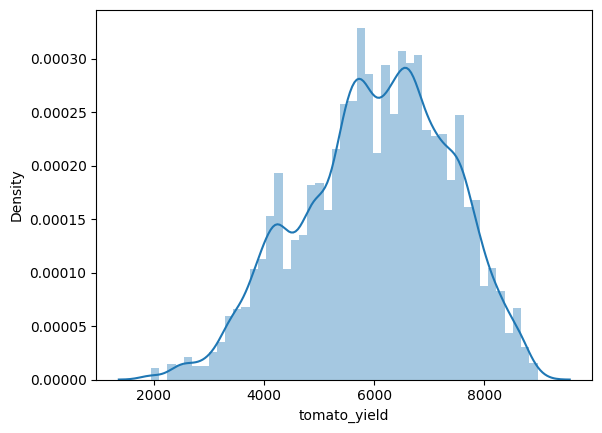

In [26]:
sns.distplot(df['tomato_yield']);

In [27]:
print("Skewness: %f" % df['Average Plant Size'].skew())
print("Kurtosis: %f" % df['tomato_yield'].kurt())

Skewness: 0.050487
Kurtosis: -0.438754


The tomato_yield distribution is almost normal, with a slight left skew (-0.2912), meaning there are slightly more high-yield cases than low-yield ones, but nothing extreme. 
The kurtosis (-0.4366) indicates a slightly flatter distribution, meaning fewer extreme values (outliers) than a normal distribution, so outliers are not a major issue.
Since the data is well-distributed and nearly symmetric, we do not need transformations, and further analysis should focus on identifying key factors influencing tomato yield.

##  Handle Outliers

We identify outliers using the IQR method.

In [28]:

# Step 1: Get numeric columns
numeric_columns = df.select_dtypes(include=["float64"]).columns

# Step 2: Function to count outliers using IQR
def count_outliers_iqr(df, columns):
    outlier_counts = []
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
        outlier_counts.append({
            "Column": col,
            "Outlier Count": len(outliers),
            "Outlier Percentage": round(100 * len(outliers) / len(df), 2)
        })
    return pd.DataFrame(outlier_counts).sort_values("Outlier Count", ascending=False)

# Step 3: Run it on your DataFrame
outlier_summary = count_outliers_iqr(df, numeric_columns)

# Show the result
print(outlier_summary)


                             Column  Outlier Count  Outlier Percentage
11                 Total Rainy Days           3568               23.34
13                        fruit_set             97                0.63
4        bee_4 Pollination Activity             56                0.37
12         Proportion of Rainy Days             49                0.32
16                     tomato_yield             25                0.16
15                    average_seeds             24                0.16
14                    mass_of_fruit             23                0.15
2        bee_2 Pollination Activity             10                0.07
3        bee_3 Pollination Activity              8                0.05
1        Bee_1 Pollination Activity              8                0.05
5   Maximum Upper Bloom Temperature              2                0.01
0                Average Plant Size              0                0.00
6   Minimum Upper Bloom Temperature              0                0.00
8   Ma

This table show us the precenge of the outliers in every numeric column we see that in the column Total rainy days the outliers are 23% and in the others is less then one precent.
In the total rainy days we see very often big changes on the data
On the other colums we see almost dont see big changes so we can assume they realy outliers and we can cut them without have a big changes on the data

## Handle Outliers

We chose to handle outliers to improve the quality of our analysis. Outliers can distort statistics, correlations, and visualizations. 

We used the IQR (Interquartile Range) method because it is simple, effective, and does not assume a normal distribution. It identifies extreme values based on the natural spread of the data and is robust against skewness and existing outliers.

For most features, the number of outliers was very small, so we removed them.

In [29]:

# Convert 'Average Upper Bloom Temperature' to numeric if needed
df["Average Upper Bloom Temperature"] = pd.to_numeric(df["Average Upper Bloom Temperature"], errors="coerce")

# Identify all float columns
numeric_columns = df.select_dtypes(include=["float64"]).columns.tolist()

# Step 1: Function to cap outliers for a specific column
def cap_outliers(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df[col] = np.where(df[col] < lower_bound, lower_bound,
                np.where(df[col] > upper_bound, upper_bound, df[col]))
    return df

# Step 2: Function to remove outliers from all other columns
def remove_outliers_except(df, exception_col, columns):
    df_filtered = df.copy()
    for col in columns:
        if col == exception_col:
            continue
        Q1 = df_filtered[col].quantile(0.25)
        Q3 = df_filtered[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df_filtered = df_filtered[(df_filtered[col] >= lower_bound) & (df_filtered[col] <= upper_bound)]
    return df_filtered

# Step 3: Apply capping to 'Total Rainy Days'
df_capped = cap_outliers(df.copy(), "Total Rainy Days")

# Step 4: Remove outliers from the rest
columns_to_filter = [col for col in numeric_columns if col != "Total Rainy Days"]
df_final = remove_outliers_except(df_capped, "Total Rainy Days", columns_to_filter)


# Result: df_final is your cleaned dataset
df=df_final.copy()



We handle the outliers by divided the data to the column of Total Rainy Days and the others:
In Total Rainy Days columns we cap the outliers-we make lower and upper bar and change all the outliers to the nearest value that in the range becuse we can't cut that big chunk of the data
in the others columns the outliers are a such small peace form all the data so we can cut the outliers without have a major issue. 

##  Normalize Numerical Features 

here we normalize the numerical features but we can see that our analysis is based on visualizations and correlation, which are not affected by the scale of the variables so after the normalization will not affect the results.




In [30]:

# Select only numeric columns
numeric_df = df.select_dtypes(include=['number'])

# Initialize the StandardScaler
scaler = StandardScaler()

# Apply standardization
standardized_data = scaler.fit_transform(numeric_df)

# Create a new DataFrame with standardized values
standardized_df = pd.DataFrame(standardized_data, columns=numeric_df.columns)

df=standardized_df.copy()



## Correlation Analysis

We focused on analyzing correlation with `tomato_yield` because it is the target variable we want to understand and explain.
The goal of the project is to find which features most strongly affect yield, so it makes sense to examine how each variable is related to it.
We chose correlation analysis because it is a fast and effective way to identify strong linear relationships between numeric features and the target.
This helps us focus on the most important variables in later visualizations and interpretation.

In [31]:
#compute the numerical correlation matrix
corr_matrix = df.corr()
corr_matrix["tomato_yield"].sort_values(ascending=False)

tomato_yield                       1.000000
fruit_set                          0.885794
average_seeds                      0.873529
mass_of_fruit                      0.826010
bee_4 Pollination Activity         0.177498
bee_2 Pollination Activity         0.157737
bee_3 Pollination Activity         0.060561
id                                 0.002922
Minimum Upper Bloom Temperature   -0.014600
Average Upper Bloom Temperature   -0.014625
Average Lower Bloom Temperature   -0.014761
Maximum Lower Bloom Temperature   -0.014888
Minimum Lower Bloom Temperature   -0.015003
Maximum Upper Bloom Temperature   -0.015204
Bee_1 Pollination Activity        -0.291820
Average Plant Size                -0.375895
Total Rainy Days                  -0.488916
Proportion of Rainy Days          -0.491720
Name: tomato_yield, dtype: float64

#the numerical correlation with tomato_yield

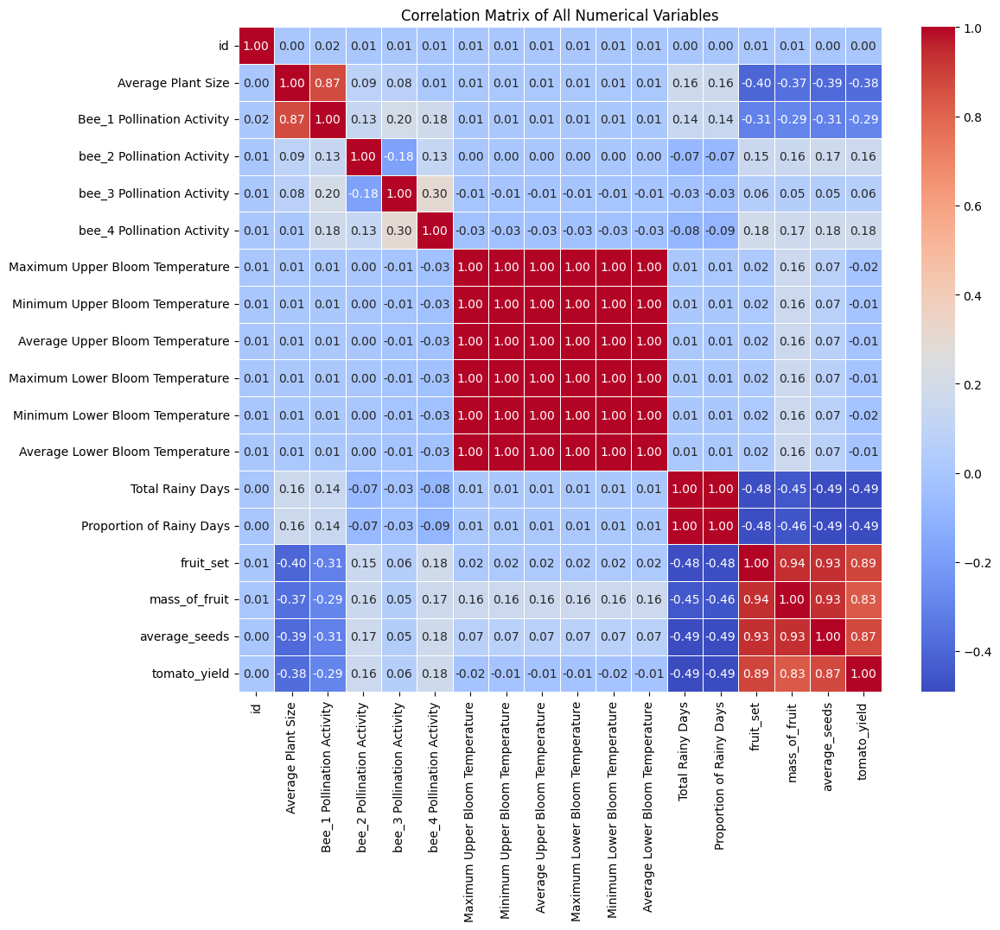

In [32]:
# Compute the visualy correlation matrix 
corr_matrix = df.corr()

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of All Numerical Variables")
plt.show()

The strongest predictors of tomato yield are fruit mass (0.94) and average seed count (0.93), indicating that yield is driven more by fruit development than external factors like weather or pollination.
Pollination activity has a weak correlation with yield (0.12 to 0.20), suggesting that while bees are essential for fruit set, other factors like fruit growth conditions and plant health play a much larger role in final yield.
 Total Rainy Days and Proportion of Rainy Days have a moderately negative correlation with yield (-0.48) , meaning excessive rain likely disrupts productivity—potentially by reducing pollination, washing away nutrients, or increasing disease risks.
 Bloom temperature variables are highly correlated with each other (~0.98), meaning they move together and may be redundant, suggesting that tracking all of them separately may not add much value 
 Fruit set has a negative correlation with plant size (-0.41), implying that larger plants may not always lead to higher productivity, possibly due to inefficient resource distribution between vegetative growth and fruit production

# Total Rainy Days vs Tomato Yield

To show not only positive but also negative influences on yield, we analyzed `Total Rainy Days`, which had a strong negative correlation with `tomato_yield`.

We used quartile-based bins to group the rainy days into four categories: Low, Medium, High, and Very High. 
The boxplot shows that higher rainy day counts tend to result in lower median yields, supporting the negative correlation we observed earlier.

In [33]:
# Create qcut bins safely, adjusting label count automatically
bins = pd.qcut(df["Total Rainy Days"], q=4, duplicates='drop')
n_bins = bins.unique().shape[0]
labels = ["Low", "Medium", "High", "Very High"][:n_bins]  # Match labels to number of bins

df["rainy_days_binned"] = pd.qcut(
    df["Total Rainy Days"], 
    q=n_bins, 
    labels=labels, 
    duplicates='drop'
)

# Boxplot
fig = px.box(
    df,
    x="rainy_days_binned",
    y="tomato_yield",
    points="outliers",
    title="Tomato Yield by Binned Total Rainy Days",
    labels={"rainy_days_binned": "Rainfall Category", "tomato_yield": "Tomato Yield"},
    color="rainy_days_binned",
    category_orders={"rainy_days_binned": labels}
)

fig.show()



# Visualize Feature Impact on Tomato Yield

We visualize the relationship between the most correlated features and `tomato_yield` using boxplots and pairplots.
These visualizations confirm the strong positive relationships we saw in the correlation analysis.
By employing boxplots and pairplots, we transformed complex agricultural data into intuitive visual narratives, revealing nuanced relationships between tomato yield and its key determinants. 
These visualization techniques not only confirmed statistical correlations but also unveiled underlying patterns that traditional numerical analysis might have obscured, providing actionable insights for optimizing tomato cultivation strategies.

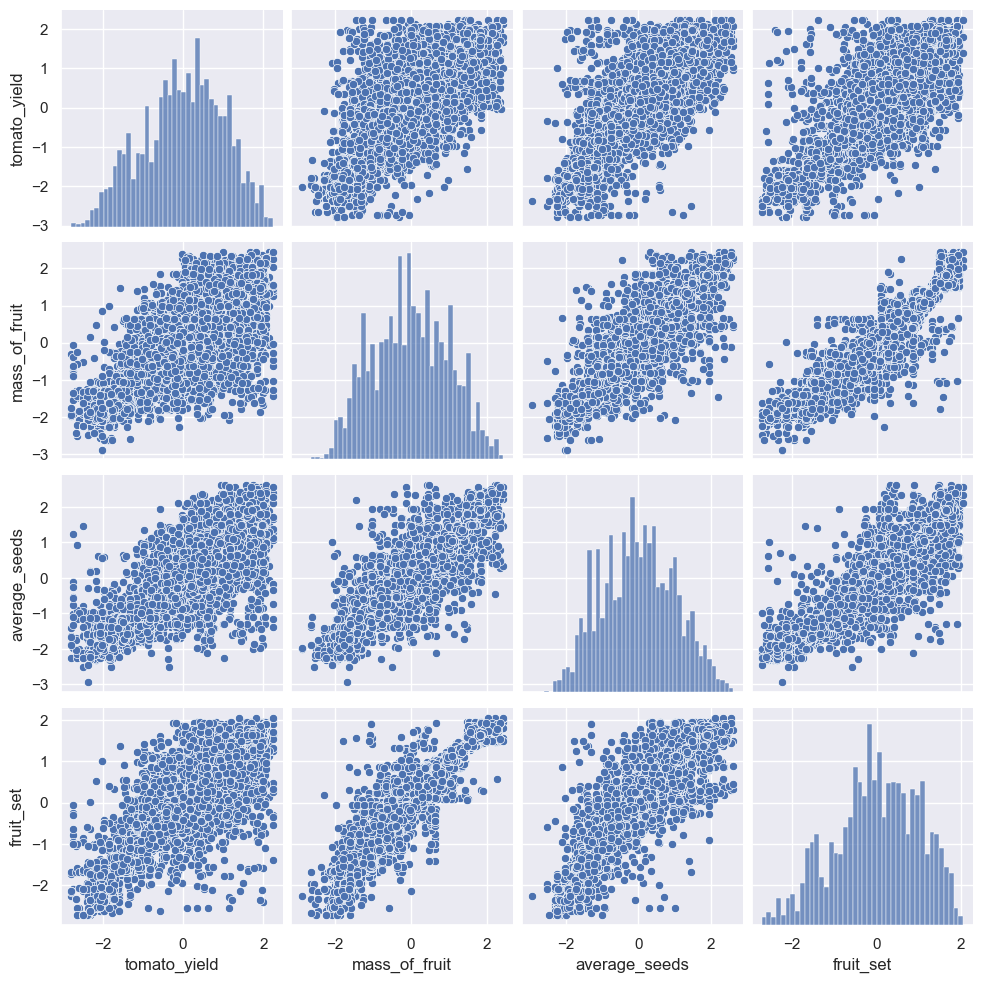

In [34]:
# Define the most correlated columns based on the correlation matrix
cols = ['tomato_yield', 'mass_of_fruit', 'average_seeds', 'fruit_set', 
        ]

# Scatterplot matrix (Pairplot)
sns.set()
sns.pairplot(df[cols], height=2.5)
plt.show()

This scatter plot confirms strong correlations between tomato yield, mass of fruit, average seeds, and fruit set.
The mass_of_fruit vs. average_seeds plot shows a clear positive trend, suggesting larger fruits have more seeds. 
Fruit set and tomato yield are also positively correlated, though some dispersion hints at other influencing factors. 
The mass_of_fruit vs. tomato_yield plot reveals a strong linear relationship, reinforcing fruit mass as a key yield driver. 
Some variables show skewed distributions, indicating possible transformation needs. 
Overall, fruit mass, seed count, and fruit set are crucial for optimizing tomato yield. 

In [35]:
df["fruit_set_binned"] = pd.qcut(df["fruit_set"], q=4, labels=["Low", "Medium", "High", "Very High"])

fig = px.box(
    df, 
    x="fruit_set_binned", 
    y="tomato_yield", 
    points="outliers",  # Only show outliers, no swarm-like effect
    title="Tomato Yield Distribution by Binned Fruit Set",
    labels={"fruit_set_binned": "Fruit Set Category", "tomato_yield": "Tomato Yield"},
    color="fruit_set_binned"
)
pio.renderers.default = "notebook"
fig.show()

We see how the fruit set affect the tomato yield (we saw thay have the strongest corlletion) 
We can see that if the fruit set is very high we can make the most profit out the tomato

In [36]:
df["average_seeds_binned"] = pd.qcut(df["average_seeds"], q=4, labels=["Low", "High", "Very High", "Medium"])

fig = px.box(
    df, 
    x="average_seeds_binned", 
    y="tomato_yield", 
    points="outliers",  # Shows only outliers
    title="Tomato Yield Distribution by Binned Average Seeds",
    labels={"average_seeds_binned": "Average Seeds Category", "tomato_yield": "Tomato Yield"},
    color="average_seeds_binned"
)
pio.renderers.default = "notebook"
fig.show()


We see how the avg seeds in the tomato affects the tomato yeild :
We saw if the tomato have in averge medium amount of seeds we can make the best profit 
We can see that in most of the time the low amount of seeds on avg make the least amount of profit there are spaicel case that it make alot 
We also see that the low avrge seeds have the biggest range of profit that he can make 

In [37]:
df["mass_of_fruit_binned"] = pd.cut(df["mass_of_fruit"], bins=4, labels=["Low", "Medium", "High", "Very High"])

fig = px.box(
    df, 
    x="mass_of_fruit_binned", 
    y="tomato_yield", 
    points="outliers",  # Shows only outliers
    title="Tomato Yield Distribution by Binned Mass of Fruit",
    labels={"mass_of_fruit_binned": "Mass of Fruit Category", "tomato_yield": "Tomato Yield"},
    color="mass_of_fruit_binned"
)

pio.renderers.default = "notebook"
fig.show()


This  plot shows strong correlations between tomato yield and mass of fruit we see that as long as we got more mass of the fruits we get a better yield 
We see that the most unusal cases are close to the range but we steel have a small smount of special dots (low mass tomatos that sold in a large yeild) that make sense because there isn't a 100 precent corlletion between them


In all of the graph we saw there isnt a 100 perecent corlletion between the categories but there are strong connections in all of them (as we see earlier)


## SUMMARY


## Key Technical Findings

Dataset: The data contained 15,289 observations with 17 features (mostly numeric traits like plant size, pollination activity, temperature, and rainfall) plus the target variable tomato_yield.

Missing Data: Missing entries were minimal. For example, 6 rows with "missing" in the Average Upper Bloom Temperature column were dropped and that column converted to numeric. After cleaning, no null values remained.

Outliers: Outliers were negligible in most features (<1% of data) and those few were removed. However, Total Rainy Days had ~23% extreme values; instead of removing such a large portion, we capped its extremes at reasonable limits to preserve the data.

Normalization: No normalization or scaling was  needed. tomato_yield was roughly normal and other features looked fine after cleaning and the normalization dont really affect the results because the Correlation stay the same after normalization.

Positive Correlations: The highest positive correlations with yield were for fruit_set, average_seeds, and mass_of_fruit (making these the strongest yield drivers). In short, higher fruit set, more seeds per fruit, and greater fruit mass all linked to higher tomato yield.

Negative Correlations: Yield showed notable negative correlations with rainy days and Average Plant Size. In other words, very wet seasons and overly large plants were associated with lower yields.


## Personal Insights

It was surprising that larger plants did not produce higher yields, suggesting bigger isn’t always better for fruiting. 
Similarly, bee pollination activity (Bee_1 to Bee_4) had only a weak effect on yield, implying pollination was not the limiting factor here. 
A practical takeaway is that excessive rainfall clearly reduced yields, underscoring the importance of water management in very wet seasons. 
Overall, the analysis highlighted that maximizing tomato yield means optimizing fruit set and fruit growth – ensuring more flowers turn into fruit – rather than just increasing plant size or pollinator numbers.